<a href="https://colab.research.google.com/github/sergiogelvez/MaterialClases/blob/main/Clase21062023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Inicio de la simulación :: datos de simulación
dx = 1.0
dt = 0.36
Tiempo máximo de simulación es: 3600 segundos
Malla de simulación de (10000,10)
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[273. 273. 273. 273. 273. 273. 273. 273. 273. 273.]
[473. 473. 473. ... 473. 473. 473.] [473. 473. 473. ... 473. 473. 473.]
10000 10000


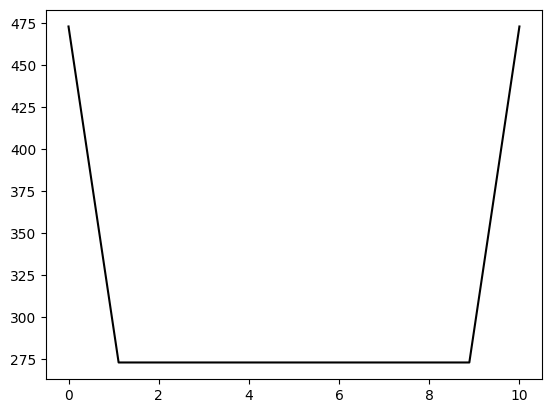

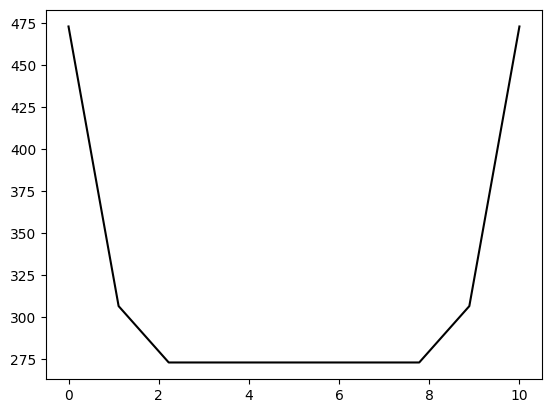

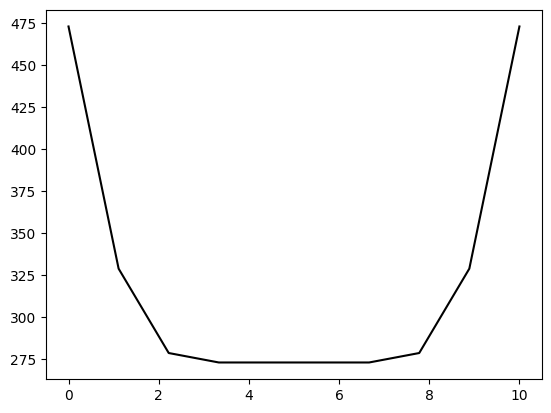

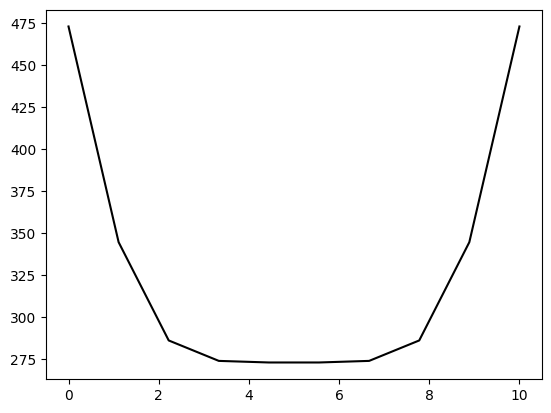

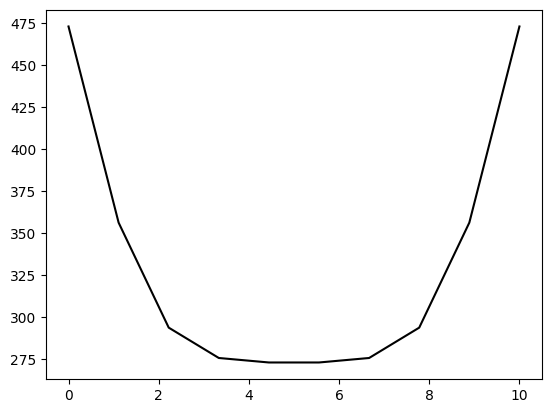

...

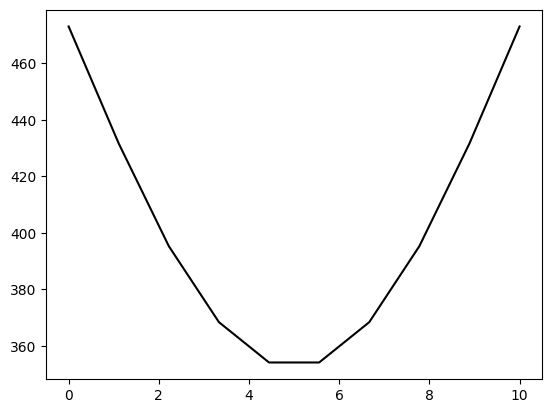

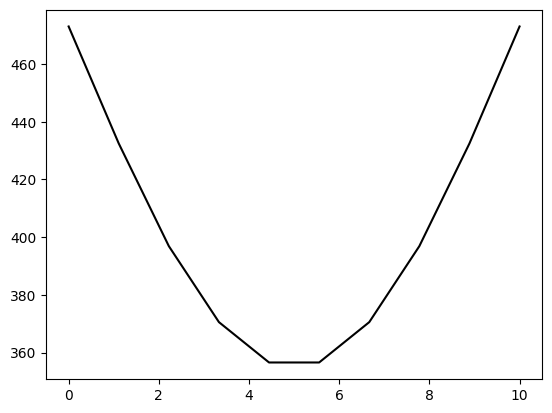

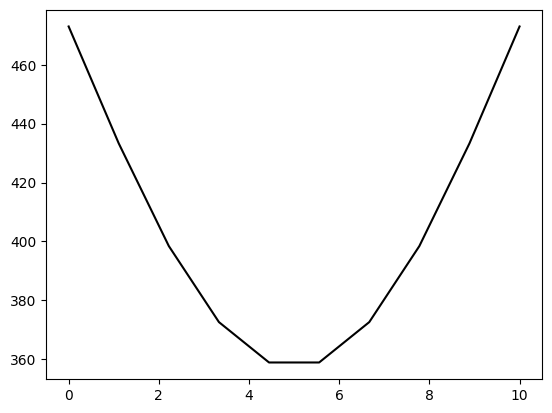

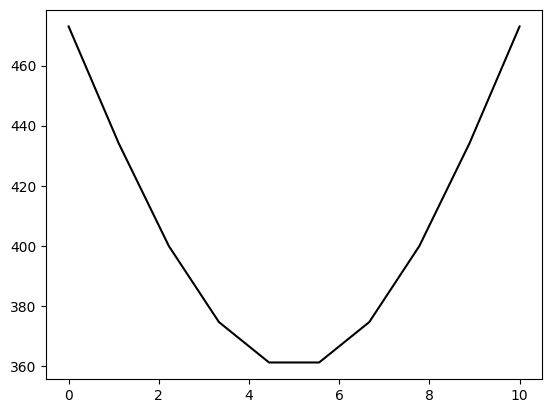

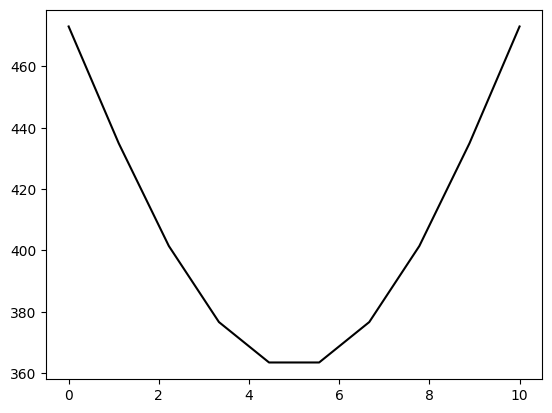

In [ ]:
#include <iostream>
#include <cmath>

import numpy as np
import math
import matplotlib.pyplot as plt


def uInicial(x) :
    #return math.sqrt(math.sin(x)**2)
    # retornar un valor en kelvin, pero no quiero ponerme existencial, así que 0 celsius -> 273 K
    return 273

# nomenclatura:
# calcular los delta a partir de las características físicas de la simulación
# ojo, t: tiempos, T: temperaturas, x: posición en x en la barra, i con x, j con t

tmax = 60 * 60  # segundos
largo = 10 # metros

pasos_t = 10000
pasos_x = 10

dt = tmax / pasos_t
dx = largo / pasos_x

k = .466 # constante

print("Inicio de la simulación :: datos de simulación")
print(f"dx = {dx}")
print(f"dt = {dt}")
print(f"Tiempo máximo de simulación es: {tmax} segundos")

#gato1 = dt * np.arange(0, pasos_t)
#gato2 = np.linspace(0, tmax, pasos_t )

#print(len(gato1), len(gato2))

if (dt <= (dx * dx) / 2) :
    U = np.zeros([pasos_t, pasos_x])
    print(f"Malla de simulación de ({pasos_t},{pasos_x})")

    # recordar, el primer indice es el tiempo (fila -> tiempo), y el segundo la x (columna -> espacio)
    '''for i in range(m):
        U[i, 0] = uInicial(i * dx)
    '''
    # condición inicial de la barra
    print(U[0, :])
    U[0, :] = uInicial(U[0, :]) # mapear la función a la primera fila usando cortes
    print(U[0, :])

    # condiciones de frontera
    U[:, 0] = 473
    U[:, pasos_x - 1] = 473

    #recordar que si quiero incluir el 0 y el x = largo, hay que agregar un espacio más
    print( U[:, 0], U[:, pasos_x - 1])
    print( len(U[:, 0]), len(U[:, pasos_x - 1]))

    # vector de posiciones en x para graficar
    x_vec = np.linspace(0, largo, pasos_x)

    # primero el ciclo del tiempo
    t = 0 # se empieza en 0 porque el método evalúa en tiempo t para escribir respuesta en t + 1
    while t < pasos_t - 1 :
        #print(f"t = { t * dt }")
        # Ahora el ciclo que recorre la longitud de la barra
        for i in range(1, pasos_x - 1):
            # print(f"posición i={i}, para t={t}")
            U[t + 1, i] = U[t, i] + k * (dt / (dx * dx)) * (U[t, i + 1] - 2 * U[t, i] + U[t, i - 1])

        plt.plot(x_vec, U[t, :], 'black')
        plt.pause(.001)
        plt.cla()

        t += 1

    plt.plot(x_vec, U[0])
    plt.ylabel("Temperature (C˚)")
    plt.xlabel("Distance Along Rod (m)")
    plt.show()
    print(U)

    #plt.imshow(U, cmap='hot')
    #plt.axes((0.0, t))
    #plt.colorbar()

    #plt.plot(x_graf, U[0, :], "*g", x_graf, U[pasos_t - 1, :], "*r", x_graf, U[100, :], "*g")
    #plt.show()


else:

    print("Los parámetros de dx y dt no permiten la convergencia.  Fin del programa")



In [ ]:
!pip install pycuda


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 24.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.4/70.4 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 11.0 MB/s eta 0:00:00
  Created wheel for pycuda: filename=pycuda-2022.2.2-cp310-cp310-linux_x86_64.whl size=661975 sha256=4d4198aa1964b99d96e90d04e415e6d563e18c3a1e14f8e2c569c35fbe447ce5
  Stored in directory: /root/.cache/pip/wheels/1d/7b/06/82a395a243fce00035dea9914d92bbef0013401497d849f8bc
Successfully built pycuda


In [ ]:
import pycuda.autoinit
import pycuda.driver as drv
import numpy

from pycuda.compiler import SourceModule
mod = SourceModule("""
__global__ void multiply_them(float *dest, float *a, float *b)
{
  const int i = threadIdx.x;
  dest[i] = a[i] * b[i];
}
""")

multiply_them = mod.get_function("multiply_them")

a = numpy.random.randn(400).astype(numpy.float32)
b = numpy.random.randn(400).astype(numpy.float32)

print(a)
print(b)

dest = numpy.zeros_like(a)
multiply_them(
        drv.Out(dest), drv.In(a), drv.In(b),
        block=(400,1,1), grid=(1,1))

print(dest**2-a*b)

[ 1.37248889e-01 -9.07715440e-01  1.16348588e+00  3.21634442e-01
 -1.60896850e+00 -1.72052369e-01 -4.03264165e-01 -8.00848007e-01
  1.18701532e-01 -8.38880420e-01 -3.14352959e-01  7.02357173e-01
  1.04298651e+00  7.56864190e-01  1.86886859e+00  6.86805010e-01
  2.01414990e+00  1.92309475e+00 -2.90787458e-01  1.75351262e-01
  2.72469491e-01 -4.63544190e-01  2.37611100e-01 -1.92039526e+00
 -4.35044795e-01  1.31637192e+00 -6.34333611e-01 -7.50011876e-02
 -1.28020060e+00 -6.68887913e-01 -9.66105878e-01  2.00178161e-01
 -1.08374131e+00 -1.52164578e+00  9.88693655e-01  1.96514428e-01
  7.64555275e-01  2.18739748e-01  4.12417173e-01  2.30526820e-01
 -1.12042654e+00 -7.67894983e-02 -3.71674657e-01  1.00589609e+00
 -1.20271230e+00  1.32643318e+00 -1.39878035e+00  4.13193256e-01
 -1.82179332e+00 -1.79383945e+00  1.48127735e+00  8.78337845e-02
  5.53877771e-01  6.58702493e-01  6.18088007e-01  2.51651835e+00
  1.40616918e+00 -1.19042850e+00  9.19768393e-01  7.61242568e-01
  4.99344200e-01  1.76466

In [ ]:
!g++ --version
!nvcc --version
!nvidia-smi

g++ (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
Copyright (C) 2019 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
Wed Jun 21 13:41:31 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+===

In [ ]:
%%writefile matmul.cu

#include "stdlib.h"
#include "stdio.h"
#include "math.h"
#include "time.h"

// Matrices are stored in row-major order:
// M(row, col) = *(M.elements + row * M.width + col)

typedef struct {
	int width;
	int height;
	double* elements;
} Matrix;

// thread block size
// #define BLOCK_SIZE 16
// #define BLOCK_SIZE 4

// Forward declaration of the matrix multiplication kernel
__global__ void MatMulKernel(const Matrix A, const Matrix B, Matrix C);

// Matrix multiplication - host code
// Matrix dimensions are assumed to be multiples of BLOCK_SIZE
void MatMul(const Matrix A, const Matrix B, Matrix C) {
	// load A and B to devic memory
	Matrix d_A;
	d_A.width = A.width;
	d_A.height = A.height;
	size_t size = A.width * A.height * sizeof(double);
	cudaMalloc(&d_A.elements, size);
	cudaMemcpy(d_A.elements, A.elements, size, cudaMemcpyHostToDevice);
	Matrix d_B;
	d_B.width = B.width;
	d_B.height = B.height;
	size = B.width * B.height * sizeof(double);
	cudaMalloc(&d_B.elements, size);
	cudaMemcpy(d_B.elements, B.elements, size, cudaMemcpyHostToDevice);
	// allocate C in device memory
	Matrix d_C;
	d_C.width = C.width;
	d_C.height = C.height;
	printf("\n\n  dimensiones de C (antes del kernel): %d, %d\n",C.width,C.height);
	size = C.width * C.height * sizeof(double);
	cudaMalloc(&d_C.elements, size);
	int BLOCK_SIZE = 16;
	// invoke kernel
	dim3 dimBlock(BLOCK_SIZE, BLOCK_SIZE);
	dim3 dimGrid(B.width / dimBlock.x, A.height / dimBlock.y);
	MatMulKernel<<<dimGrid,dimBlock>>>(d_A,d_B,d_C);
	// Read C from device memory
	cudaMemcpy(C.elements, d_C.elements, size, cudaMemcpyDeviceToHost);
	// porqueria
	int i,j;
	printf("\n\n  dimensiones de C: %d, %d\n",C.height,C.width);
	/*for (i=0; i< C.width ; ++i)
	for (j=0; j < C.height; ++j) {
		//printf("\n\n%f", C.elements[i*C.width+j]);
	}*/


	// free device memory
	cudaFree(d_A.elements);
	cudaFree(d_B.elements);
	cudaFree(d_C.elements);
}

// Matrix multiplication kernel called by MatMul()
__global__ void MatMulKernel(Matrix A, Matrix B, Matrix C) {
	// each thread compute one element of C
	// by acumulating results into Cvalue
	double Cvalue = 0;
	int row = blockIdx.y * blockDim.y + threadIdx.y;
	int col = blockIdx.x * blockDim.x + threadIdx.x;
	for (int e = 0; e < A.width; ++e) {
		Cvalue = Cvalue + A.elements[row *A.width + e] * B.elements[e * B.width + col];
	}
	C.elements[row * C.width + col] = Cvalue;
}

size_t index(int filas, int cols, int ancho)
{
	return (filas *  ancho + cols);
}

int main( int argc, char** argv) {
	// crear dos matrices guardadas en row major order, y una más para el resultado
	int filas = 1024;
	int cols;
	cols = filas;

	// double A_elem, B_elem, C_elem;
	Matrix A, B, C;

	double* A_elem = new double[filas * cols];
	double* B_elem = new double[filas * cols];
	double* C_elem = new double[filas * cols];
	double* C_elem_GPU = new double[filas * cols];

	// vamos al ejemplo de la matriz cuadrada, 8x8
	A.width = cols;
	B.width = cols;
	C.width = cols;
	A.height = filas;
	B.height = filas;
	C.height = filas;

	int count = 0;
	int i, j, k;
	printf("\n\n\n\n\n");
	printf("\n************************************\n");
	printf("Prueba de multiplicacion de matrices");
	printf("\n************************************\n");
	// llenado de la matriz A.
	for (i=0; i< A.width ; ++i)
	{
		for (j=0; j < A.height; ++j)
		{
			A_elem[index(i, j, cols)] = rand()%10*1.0;

		}
	}
	// llenado de la matriz B.
	for (i=0; i< B.width ; ++i) {
		for (j=0; j < B.height; ++j) {
			B_elem[index(i, j, cols)] = rand()%10*1.0;
		}
	}
	// Ahora la impresión inicial de las dos matrices

	// La A
	count = 0;
	printf("\n\n -- Matriz A --\n");
	for (i=0; i< A.width ; ++i) {
		// printf("\n");
		for (j=0; j < A.height; ++j) {
			// printf(" %3.2f ", A_elem[index(i, j, A.width)]);
			count++;
		}
		//printf("\n");
	}
	printf("\nContador = %d", count);

	// ahora la B
	count = 0;
	printf("\n\n -- Matriz B --\n");
	for (i=0; i< B.width ; ++i) {
		// printf("\n");
		for (j=0; j < B.height; ++j) {
			// printf(" %3.2f ", B_elem[index(i, j, B.width)]);
			count++;
		}
		//printf("\n");
	}
	printf("\nContador = %d", count);

	// Creación de las matrices en memoria de la GPU
	// Cálculo del tamaño de la matriz en memoria, matriz A
	size_t size = A.width*A.height*sizeof(double);
	A.elements = (double*)malloc(size);
	// Asignación elementos uno a uno
	for (i=0; i< A.width ; ++i) {
		for (j=0; j < A.height; ++j) {
			A.elements[i*A.width+j] = A_elem[index(i, j, A.width)];
		}
	}
	// Cálculo del tamaño de la matriz en memoria, matriz B
	size = B.width*B.height*sizeof(double);
	B.elements = (double*)malloc(size);
	for (i=0; i< B.width ; ++i) {
		for (j=0; j < B.height; ++j) {
			B.elements[i*B.width+j] = B_elem[index(i, j, B.width)];
		}
	}
	// pasar la mat a la funcion MulMat
	C.elements = (double*)malloc(size);
	// aca hay que incluir el codigo que lleva control del tiempo
	clock_t tinicio, t_GPU;
	float tg,tc;
	tinicio=clock();
	//
	MatMul(A,B,C);
	//
	t_GPU=clock();
	tg = ((float)t_GPU-(float)tinicio)/CLOCKS_PER_SEC;
	printf("\n\ntiempo de procesamiento (GPU): %6.3f s\n\n",tg);
	// aca se calculó el tiempo de la GPU, ahora la prueba y la CPU


	for (i=0; i< C.width ; ++i) {
		for (j=0; j < C.height; ++j) {
			C_elem_GPU[index(i, j, C.width)] = C.elements[i * C.width + j];
		}
	}
	printf("\n -- Matrix resultante (GPU) --\n");
	for (i=0; i< C.width ; ++i) {
		//printf("\n");
		for (j=0; j < C.height; ++j) {
			// printf(" %3.2f ", C_elem_GPU[index(i, j, C.width)]);
		}
		//printf("\n");
	}


	// aca vamos a realizar la multiplicacion de matrices mediante la cpu.
	// se analizaran los resultados.
	tinicio=clock();
	//
	for (i=0; i < A.height ; ++i) {
		for (j=0; j < B.width; ++j) {
			C_elem[index(i, j, C.width)] = 0;
			for(k=0 ; k < A.width; k++) {
				C_elem[index(i, j, C.width)] = C_elem[index(i, j, C.width)] + A_elem[index(i, k, A.width)] * B_elem[index(k, j, B.width)];
			}
		}
	}
	//
	t_GPU=clock();
	tc = ((float)t_GPU-(float)tinicio)/CLOCKS_PER_SEC;
	printf("\n\ntiempo de procesamiento (CPU): %6.3f s\n\n",tc);
	printf("\n -- Matrix resultante (CPU) - (GPU) --\n");
	for (i=0; i< C.width ; ++i) {
		printf("\n");
		for (j=0; j < C.height; ++j) {
			printf(" %3.2f -> %3.2f ", C_elem[index(i, j, C.width)], C.elements[index(i, j, C.width)]);
		}
		printf("\n");
	}
}


Writing matmul.cu


In [ ]:
!nvcc -o matmul.o matmul.cu
!./matmul.o

matmul.cu(54): warning #177-D: variable "i" was declared but never referenced

matmul.cu(54): warning #177-D: variable "j" was declared but never referenced







************************************
Prueba de multiplicacion de matrices
************************************


 -- Matriz A --

Contador = 1048576

 -- Matriz B --

Contador = 1048576

  dimensiones de C (antes del kernel): 1024, 1024


  dimensiones de C: 1024, 1024


tiempo de procesamiento (GPU):  0.281 s


 -- Matrix resultante (GPU) --


tiempo de procesamiento (CPU): 25.379 s


 -- Matrix resultante (CPU) - (GPU) --

 20670.00 -> 20670.00  21121.00 -> 21121.00  21211.00 -> 21211.00  20492.00 -> 20492.00  20707.00 -> 20707.00  20947.00 -> 20947.00  20711.00 -> 20711.00  19892.00 -> 19892.00  21546.00 -> 21546.00  21634.00 -> 21634.00  21181.00 -> 21181.00  21597.00 -> 21597.00  20780.00 -> 20780.00  20366.00 -> 20366.00  20203.00 -> 20203.00  21895.00 -> 21895.00  19978.00 -> 19978.00  21309.00 -> 21309.00  20812.00 -

In [ ]:
!cat /proc/cpuinfo
!cat /proc/meminfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 79
model name	: Intel(R) Xeon(R) CPU @ 2.20GHz
stepping	: 0
microcode	: 0xffffffff
cpu MHz		: 2199.998
cache size	: 56320 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 hle avx2 smep bmi2 erms invpcid rtm rdseed adx smap xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs taa mmio_stale_data retbleed
bogomips	: 4399.99
clflush size	: 64
cache_alignment	: 64
addres